## Evaluating Topic Models and Identifying Uncertainty Related Keywords

**To be tested**
1. Top2Vec with Sentence Transformers
2. LDA Mallet
3. Tuning LDA Multicore

In [1]:
# NB config
%load_ext autoreload
%autoreload 2

import os
os.chdir("../../..")
print(os.getcwd())
from pathlib import Path
import gensim
import pyLDAvis
import pyLDAvis.gensim_models as gensimvis
from top2vec import Top2Vec
import pandas as pd
import altair as alt
from nlp.topic_models.lda.stream_corpus import StreamingCorpus
from nlp.topic_models.lda.bigram_corpus import BigramStreamingCorpus
from utils import check_and_create_dir

/Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index


/Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/matplotlib_inline/config.py:66: DeprecationWarning: InlineBackend._figure_formats_changed is deprecated in traitlets 4.1: use @observe and @unobserve instead.
  def _figure_formats_changed(self, name, old, new):


In [2]:
# Config
from IPython.display import display, HTML
pyLDAvis.enable_notebook()

# HTML save dir
lda_viz_save_dir = Path("nlp/topic_models/analytics/lda_vizzes")
check_and_create_dir(lda_viz_save_dir)

Directory already exists!


### 1. Gensim LDA
#### ```U-Mass Coherence Score``` against ```K (No. of Topics)```

In [3]:
# Plot coherence against K
umass = []
K = []

In [4]:
# These are common across all models (Trained on entire corpus)
raw_data_dir = 'nlp/topic_models/data/processed_reddit'

# Load Corpus
file_paths = list(Path(str(raw_data_dir)).rglob("*.csv"))
corpus = StreamingCorpus(
    csv_file_paths=file_paths,
    load_from_saved_fp='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/dictionary.txt'
)
# Load Dictionary
dict = corpus.corpus_dict

[2022-02-21 02:16:41] INFO     Constructing Dictionary                    ]8;id=289242;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=653797;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#43\43]8;;\

                      INFO     Dictionary loaded: Dictionary(41259 unique ]8;id=465631;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py\stream_corpus.py]8;;\:]8;id=985955;file:///Users/christopherliew/Desktop/Y4S1/HT/crypto_uncertainty_index/nlp/topic_models/lda/stream_corpus.py#51\51]8;;\
                               tokens: ['_', '__', '____id____', '__cb',                     
                               '__cf_chl_jschl_tk__']...)                                    

#### 1.1 Reddit Unigram Corpus (K = 10)
* ```U_mass Coherence``` = -2.0598

In [5]:
# Load Dictionary
# Load models
model_10 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 19:37:40.104339/lda_model_10_-2.0598494174211925.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=293145;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=113705;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=653942;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=114979;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=400477;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=2021;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=221803;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=550180;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=784448;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=163544;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=600392;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=595943;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=137582;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=59950;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=251314;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=231370;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 19             
                               :37:40.104339/lda_model_10_-2.0598494174211925.ld             
                               a.state                                                       

In [6]:
# Prepare LDA Viz
# viz_10 = gensimvis.prepare(model_10, corpus, dict)
# pyLDAvis.save_html(viz_10, str(lda_viz_save_dir / 'lda_10_result.html'))

In [7]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_10_result.html')))

#### 1.2 Reddit Unigram Corpus (K = 20)
* ```U_mass Coherence``` = -2.4073

In [8]:
# Load models
model_20 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_20_-2.4072564582036913.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=991367;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=841492;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=155705;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=877739;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=554036;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=573993;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=285931;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=429742;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=646402;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=928936;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=587729;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=510185;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=541035;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=707328;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=758042;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=353003;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_20_-2.4072564582036913.ld             
                               a.state                                                       

In [9]:
# Prepare LDA Viz
# viz_20 = gensimvis.prepare(model_20, corpus, dict)
# pyLDAvis.save_html(viz_20, str(lda_viz_save_dir / 'lda_20_result.html'))

In [10]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_20_result.html')))

#### 1.3 Reddit Unigram Corpus (K = 30)
* ```U_mass Coherence``` = -2.529

In [11]:
# Load models
model_30 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_30_-2.5285975052666823.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=286326;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=415988;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=537040;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=224582;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=204982;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=977150;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=996367;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=558031;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=31254;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=172227;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=563432;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=537816;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=202017;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=471446;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=655750;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=178553;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_30_-2.5285975052666823.ld             
                               a.state                                                       

In [12]:
# Prepare LDA Viz
# viz_30 = gensimvis.prepare(model_30, corpus, dict)
# pyLDAvis.save_html(viz_30, 'lda_30_result.html')

In [13]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_30_result.html'))

#### 1.4 Reddit Unigram Corpus (K = 40)
* ```U_mass Coherence``` = -2.861

In [14]:
# Load models
model_40 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 23:50:42.565349/lda_model_40_-2.8613551344890014.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=599163;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=203037;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=568336;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=463679;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute dispatcher to None      ]8;id=266396;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=603409;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=948196;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=62611;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=972233;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=198482;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=69193;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=497261;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=953984;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=481442;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=825947;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=388007;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 23             
                               :50:42.565349/lda_model_40_-2.8613551344890014.ld             
                               a.state                                                       

In [15]:
# Prepare LDA Viz
# viz_40 = gensimvis.prepare(model_40, corpus, dict)
# pyLDAvis.save_html(viz_40, 'lda_40_result.html')

In [16]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_40_result.html'))

#### 1.5 Reddit Unigram Corpus (K = 50)
* ```U_mass Coherence``` = -2.946

In [17]:
# Load models
model_50 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-17 02:30:37.967859/lda_model_50_-2.9458478905345857.lda'
)

[2022-02-21 02:16:42] INFO     loading LdaModel object from                      ]8;id=435119;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=109944;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=292868;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=782413;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute id2word to None         ]8;id=400261;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=138358;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=627400;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=951552;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=851199;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=50591;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=581555;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=885634;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=200151;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=71173;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=356413;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=14272;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-17 02             
                               :30:37.967859/lda_model_50_-2.9458478905345857.ld             
                               a.state                                                       

In [18]:
# Prepare LDA Viz
# viz_50 = gensimvis.prepare(model_50, corpus, dict)
# pyLDAvis.save_html(viz_50, str(lda_viz_save_dir / 'lda_50_result.html'))

In [19]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_50_result.html')))

#### 1.6 Reddit Unigram Corpus (K = 100)
* ```U_mass Coherence``` = -4.099

In [20]:
# Load models
model_100 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_100_-4.09886666032905.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=969091;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=615469;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading expElogbeta from                          ]8;id=668984;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=244355;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .expElogbeta.npy with mmap=None                               

                      INFO     setting ignored attribute state to None           ]8;id=632487;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=963996;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=910759;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=576498;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=582360;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=719592;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=259605;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=307559;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             

                      INFO     loading LdaState object from                      ]8;id=580228;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=499339;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

                      INFO     loaded                                            ]8;id=217645;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=254427;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_100_-4.09886666032905.lda             
                               .state                                                        

In [21]:
# Prepare LDA Viz
# viz_100 = gensimvis.prepare(model_100, corpus, dict)
# pyLDAvis.save_html(viz_100, str(lda_viz_save_dir / 'lda_100_result.html'))

In [22]:
# Visualise
display(HTML(str(lda_viz_save_dir / 'lda_100_result.html')))

#### 1.7 Reddit Unigram Corpus (K = 200)
* ```U_mass Coherence``` = -4.548

In [23]:
# Load models
model_200 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_200_-4.547866172320138.lda'
)

[2022-02-21 02:16:43] INFO     loading LdaModel object from                      ]8;id=806789;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=871549;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=142522;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=930730;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=302036;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=973657;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=810620;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=324852;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=323697;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=303015;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=936819;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=386847;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=145699;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=548291;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.state                                                       

                      INFO     loaded                                            ]8;id=517297;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=984449;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_200_-4.547866172320138.ld             
                               a.state                                                       

In [24]:
# Prepare LDA Viz
# viz_200 = gensimvis.prepare(model_200, corpus, dict)
# pyLDAvis.save_html(viz_200, 'lda_200_result.html')

In [25]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_200_result.html'))

#### 1.8 Reddit Unigram Corpus (K = 300)
* ```U_mass Coherence``` = -4.675

In [26]:
# Load models
model_300 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-16 14:35:28.242947/lda_model_300_-4.675032900840325.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=271165;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=852233;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a                                                             

                      INFO     loading expElogbeta from                          ]8;id=809887;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=146639;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.expElogbeta.npy with mmap=None                              

                      INFO     setting ignored attribute state to None           ]8;id=191962;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=837167;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=408746;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=473093;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute id2word to None         ]8;id=817044;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=384284;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=268545;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=454782;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a                                                             

                      INFO     loading LdaState object from                      ]8;id=424327;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=712063;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state                                                       

                      INFO     loading sstats from                               ]8;id=739663;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=666631;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state.sstats.npy with mmap=None                             

                      INFO     loaded                                            ]8;id=368935;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=812963;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-16 14             
                               :35:28.242947/lda_model_300_-4.675032900840325.ld             
                               a.state                                                       

In [27]:
# Prepare LDA Viz
# viz_300 = gensimvis.prepare(model_300, corpus, dict)
# pyLDAvis.save_html(viz_300, 'lda_300_result.html')

In [28]:
# Visualise
# display(HTML(lda_viz_save_dir / 'lda_300_result.html'))

### Bigram Models

In [29]:
# Load Corpus
# bigram_corpus = BigramStreamingCorpus(
#     csv_file_paths=file_paths,
#     load_from_saved_bigram = 'nlp/topic_models/models/bigram/reddit_bigram_full',
# )

# Load Dictionary
# bigram_dict = bigram_corpus.corpus_dict

#### 1.9 Reddit Bigram Corpus (K = 5)
* ```U_mass Coherence``` = -3.045

In [30]:
# Load models
bigram_model_5 = gensim.models.LdaModel.load(
    fname='nlp/topic_models/models/lda/lda_run_2022-02-20 05:44:41.044518/lda_bigram_model_5_-3.0450798134890427.lda'
)

                      INFO     loading LdaModel object from                      ]8;id=274328;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=340048;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda                                                       

                      INFO     loading expElogbeta from                          ]8;id=379403;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=923072;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#470\470]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.expElogbeta.npy with mmap=None                        

                      INFO     setting ignored attribute id2word to None         ]8;id=646144;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=444066;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute state to None           ]8;id=649694;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=480700;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     setting ignored attribute dispatcher to None      ]8;id=704414;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=469800;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#503\503]8;;\

                      INFO     loaded                                            ]8;id=450101;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=71867;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda                                                       

                      INFO     loading LdaState object from                      ]8;id=963619;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=63679;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#431\431]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.state                                                 

                      INFO     loaded                                            ]8;id=91629;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py\utils.py]8;;\:]8;id=618168;file:///Users/christopherliew/Library/Caches/pypoetry/virtualenvs/crypto-uncertainty-index-NHOdNUJC-py3.8/lib/python3.8/site-packages/gensim/utils.py#437\437]8;;\
                               nlp/topic_models/models/lda/lda_run_2022-02-20 05             
                               :44:41.044518/lda_bigram_model_5_-3.0450798134890             
                               427.lda.state                                                 

In [31]:
# bigram_5_top_topics = bigram_model_5.top_topics(bigram_corpus)

In [32]:
# Prepare LDA Viz
# bigram_viz_5 = gensimvis.prepare(bigram_model_5, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_5, str(lda_viz_save_dir / 'lda_bigram_5_result.html'))

In [33]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_5_result.html')))

#### 1.10 Reddit Bigram Corpus (K = 10)
* ```U_mass Coherence``` = -15.872

In [34]:
# Load models
# bigram_model_10 = gensim.models.LdaModel.load(
#    fname='nlp/topic_models/models/lda/lda_run_2022-02-20 17:58:52.974895/lda_model_10_-15.871570660518893.lda'
# )

In [35]:
# Prepare LDA Viz
# bigram_viz_10 = gensimvis.prepare(bigram_model_10, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_10, str(lda_viz_save_dir / 'lda_bigram_10_result.html'))

In [36]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_10_result.html')))

#### 1.11 Reddit Bigram Corpus (K = 20)
* ```U_mass Coherence``` = -3.475

In [37]:
# Load models
# bigram_model_20 = gensim.models.LdaModel.load(
#     fname='nlp/topic_models/models/lda/lda_run_2022-02-20 14:26:53.236168/lda_bigram_model_20_-3.475424501239462.lda'
# )

In [38]:
# Prepare LDA Viz
# bigram_viz_20 = gensimvis.prepare(bigram_model_20, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_model_20, str(lda_viz_save_dir / 'lda_bigram_20_result.html'))

In [39]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_20_result.html')))

#### 1.12 Reddit Bigram Corpus (K = 50)
* ```U_mass Coherence``` = -4.818

In [40]:
# Load models
# bigram_model_50 = gensim.models.LdaModel.load(
#    fname='nlp/topic_models/models/lda/lda_run_2022-02-20 15:07:13.374803/lda_bigram_model_50_-4.818418907269378.lda'
# )

In [41]:
# Prepare LDA Viz
# bigram_viz_50 = gensimvis.prepare(bigram_model_50, bigram_corpus, bigram_dict)
# pyLDAvis.save_html(bigram_viz_50, str(lda_viz_save_dir / 'lda_bigram_50_result.html'))

In [42]:
# Visualise
# display(HTML(str(lda_viz_save_dir / 'lda_bigram_50_result.html')))

### 2. Top2Vec
#### 2.1 Sampled Corpus (5%)
**UMAP Normal Memory**

In [43]:
t2v5_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_5")

In [44]:
print(f"Number of Topics: {t2v5_model.get_num_topics()}")

Number of Topics: 2770


**Identify Topics Related to Price Uncertainty**

In [45]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v5_model.search_topics(
        keywords=["uncertainty", "price"],
        num_topics=10
    )
)

In [46]:
topic_scores

array([0.52479882, 0.4651586 , 0.45333596, 0.33911777, 0.33407077,
       0.32969925, 0.31090215, 0.31039308, 0.3086697 , 0.30410639])

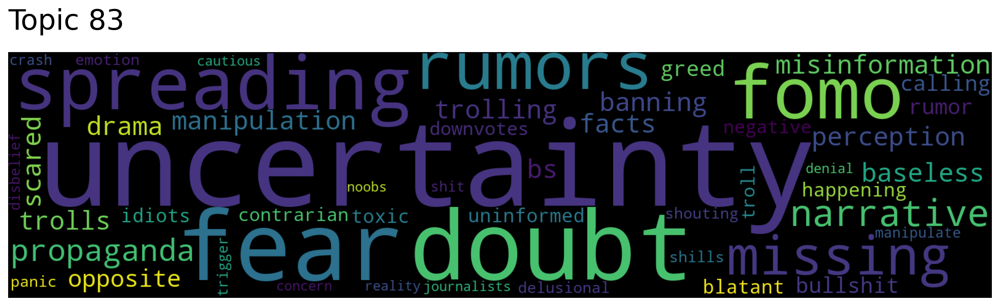

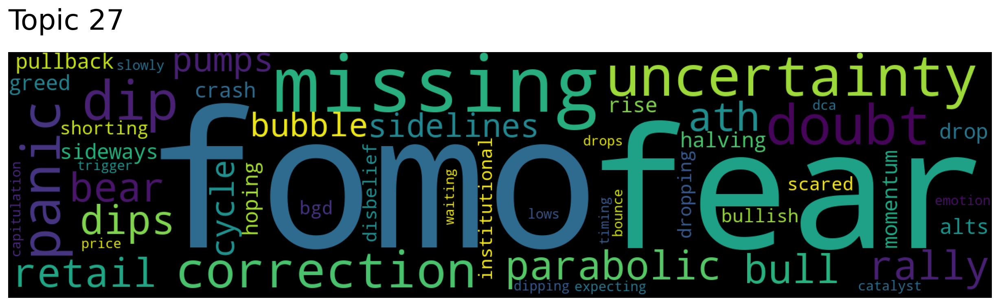

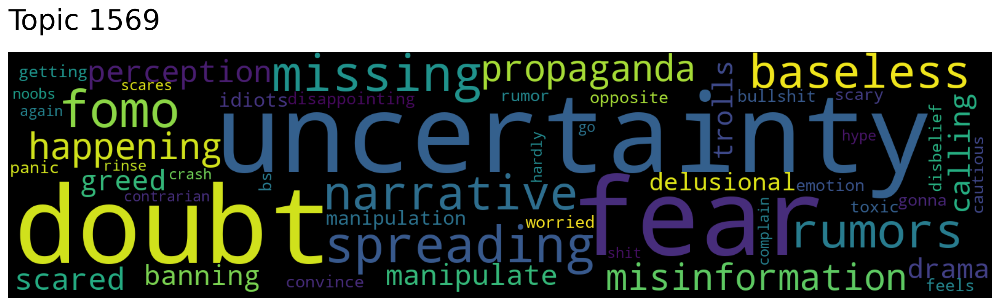

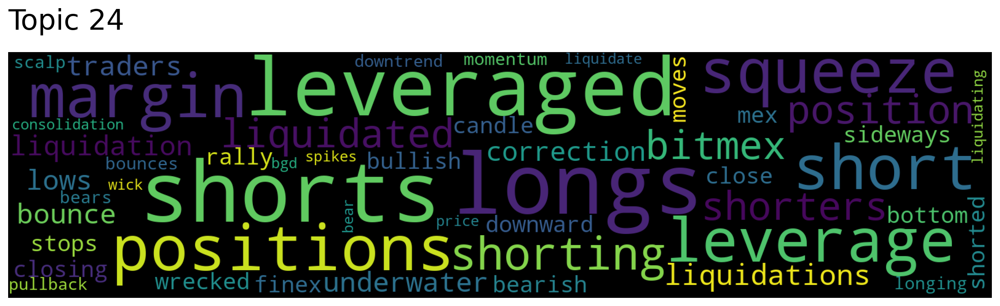

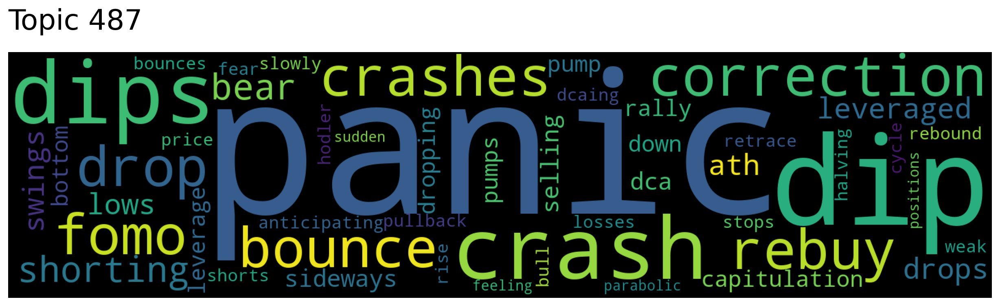

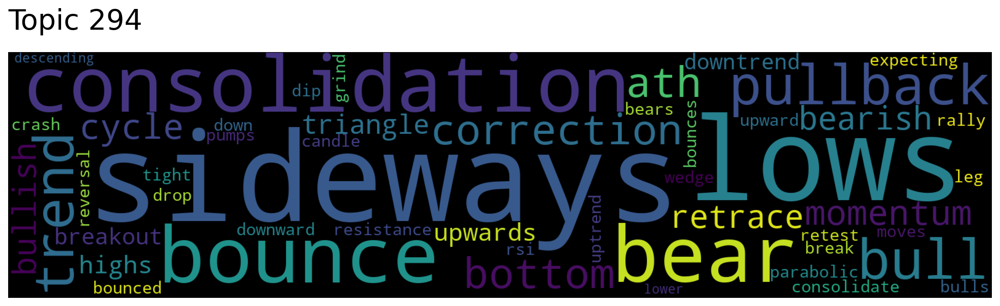

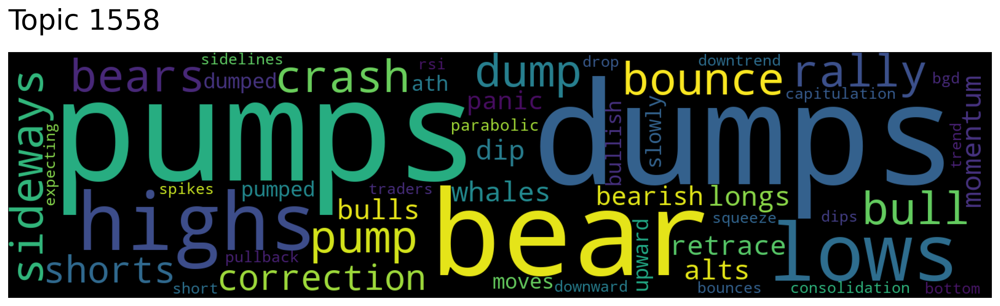

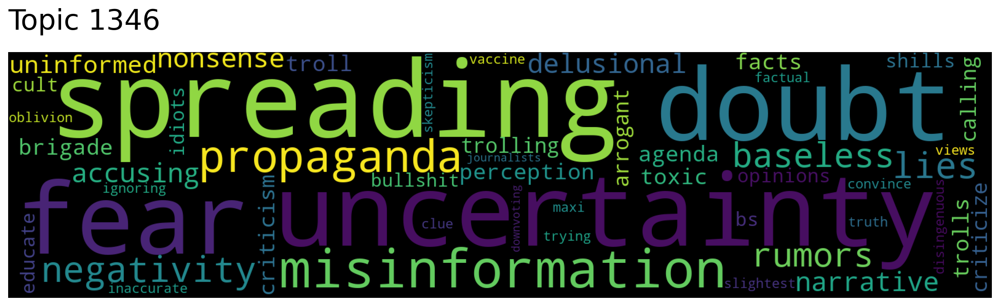

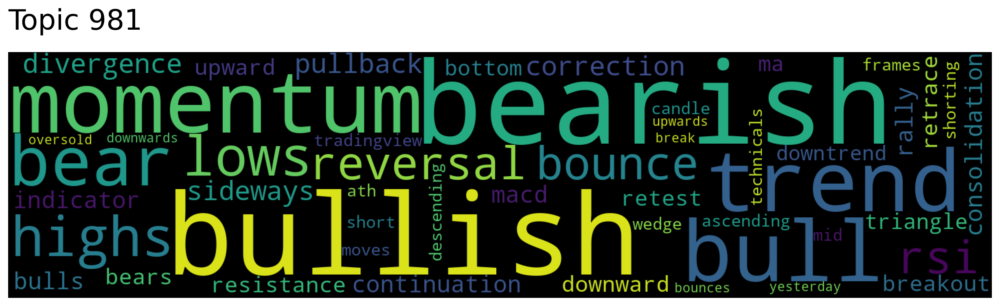

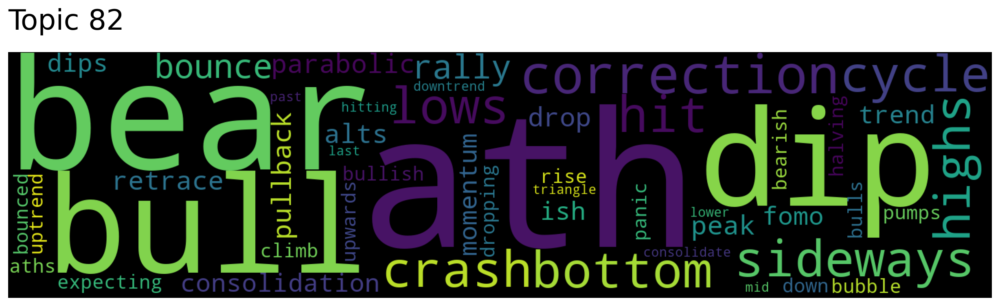

In [47]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [48]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v5_model.search_topics(
        keywords=["uncertainty", "policy"],
        num_topics=10
    )
)

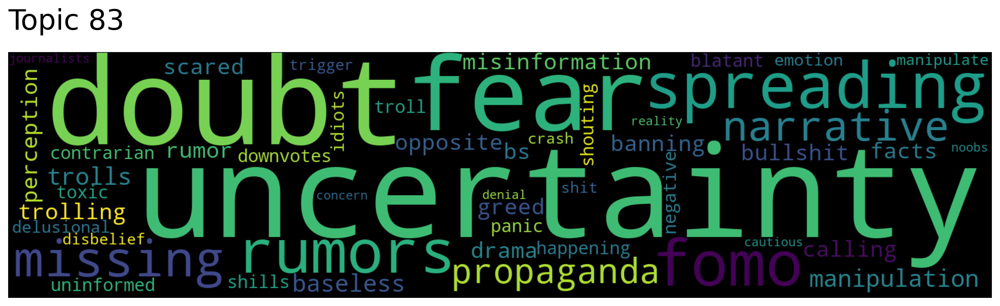

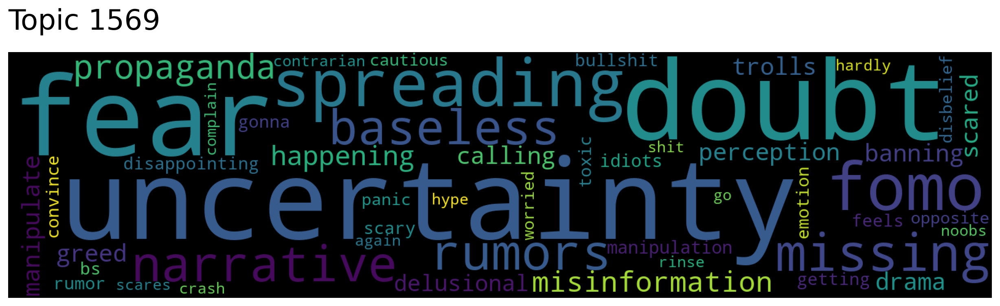

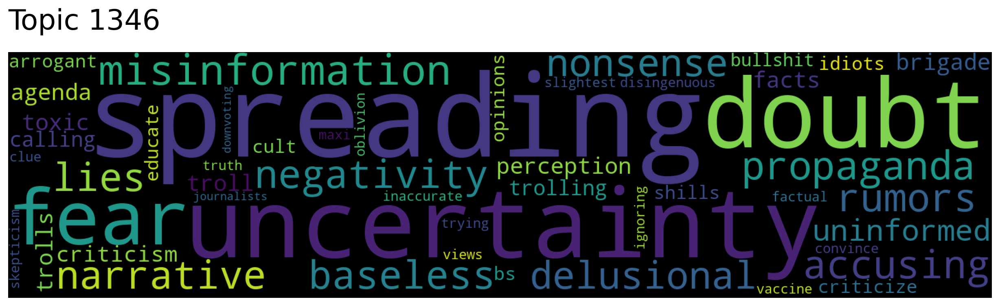

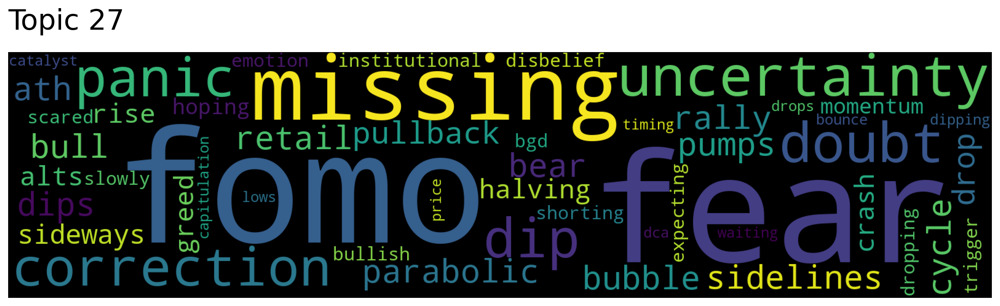

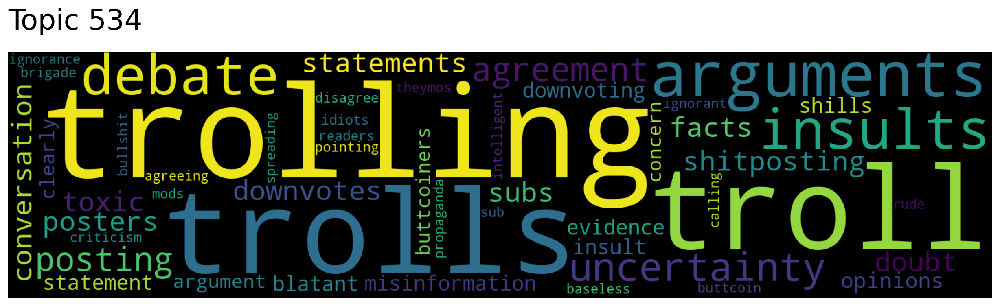

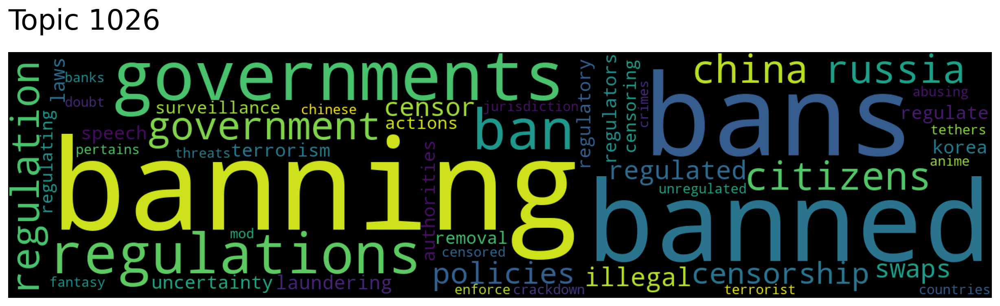

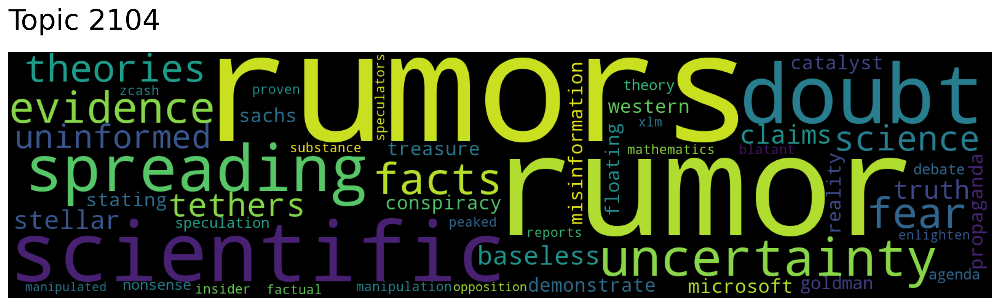

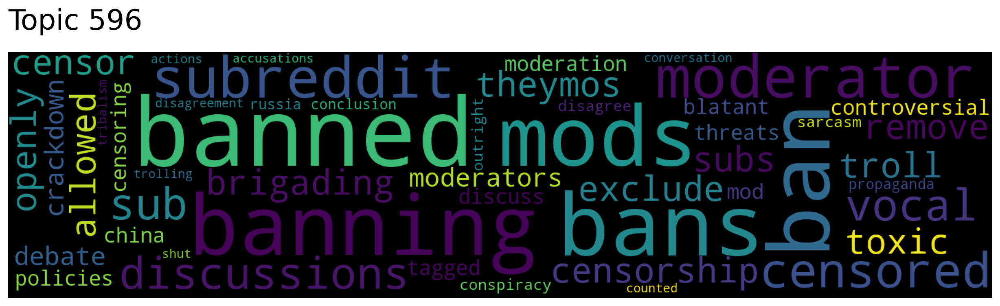

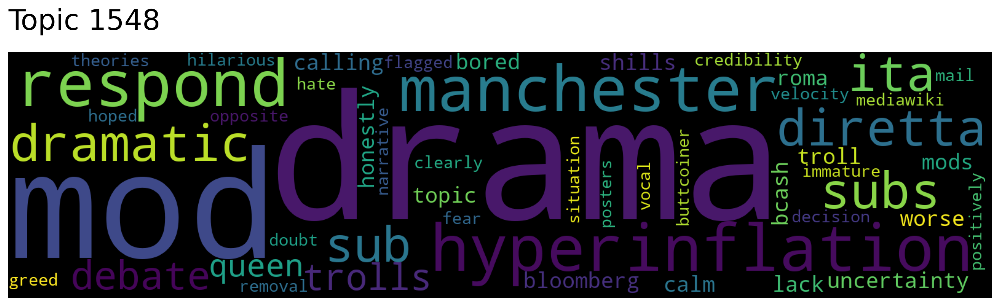

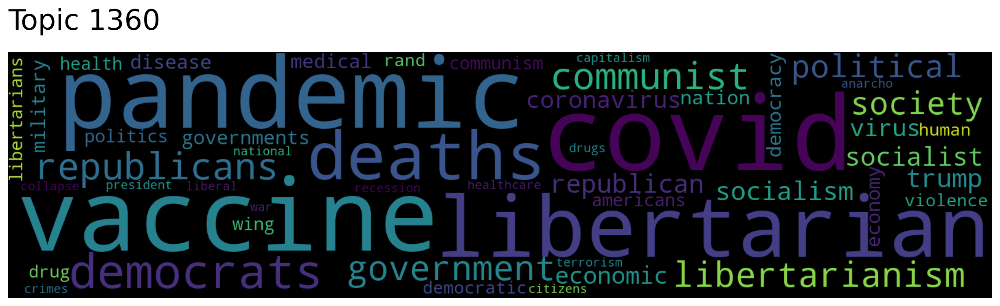

In [49]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v5_model.generate_topic_wordcloud(topic)

#### 2.2 Sampled Corpus (10%)

In [50]:
t2v10_model = Top2Vec.load("nlp/topic_models/models/top2vec/top2vec_learn_doc2vec_10")

In [51]:
print(f"Number of Topics: {t2v10_model.get_num_topics()}")

Number of Topics: 4228


**Identify Topics Related to Price Uncertainty**

In [52]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v10_model.search_topics(
        keywords=["uncertainty", "price"],
        num_topics=10
    )
)

In [53]:
# Pick relevant topics
topic_scores

array([0.49114595, 0.4324447 , 0.38161118, 0.34820314, 0.3260173 ,
       0.3250976 , 0.32134587, 0.31216908, 0.31079477, 0.30332922])

In [60]:
len(topic_words[0])

50

In [54]:
# Pick relevant words in relevant topics
list(zip(list(topic_words[0]), list(word_scores[0])))

[('uncertainty', 0.72409743),
 ('fear', 0.70776016),
 ('doubt', 0.67005664),
 ('spreading', 0.49395713),
 ('fomo', 0.44544762),
 ('narrative', 0.40840736),
 ('misinformation', 0.393205),
 ('missing', 0.37283644),
 ('panic', 0.35924244),
 ('baseless', 0.32947832),
 ('disinformation', 0.32821208),
 ('mongering', 0.32693008),
 ('manipulate', 0.31614727),
 ('manipulation', 0.31588498),
 ('orchestrated', 0.31426892),
 ('propaganda', 0.30862248),
 ('fudding', 0.30104932),
 ('trolling', 0.2950872),
 ('rumors', 0.29495695),
 ('shills', 0.2857758),
 ('troll', 0.2826002),
 ('blatant', 0.28236017),
 ('emotion', 0.27979544),
 ('trolls', 0.27558774),
 ('greed', 0.2714109),
 ('lies', 0.27124107),
 ('negativity', 0.2671276),
 ('banning', 0.2659008),
 ('facts', 0.25894794),
 ('warranted', 0.25236708),
 ('sockpuppet', 0.25100338),
 ('nonsense', 0.2504321),
 ('opinions', 0.25023827),
 ('narratives', 0.24959046),
 ('scares', 0.24932888),
 ('truth', 0.24677812),
 ('emotional', 0.24597673),
 ('slightest', 

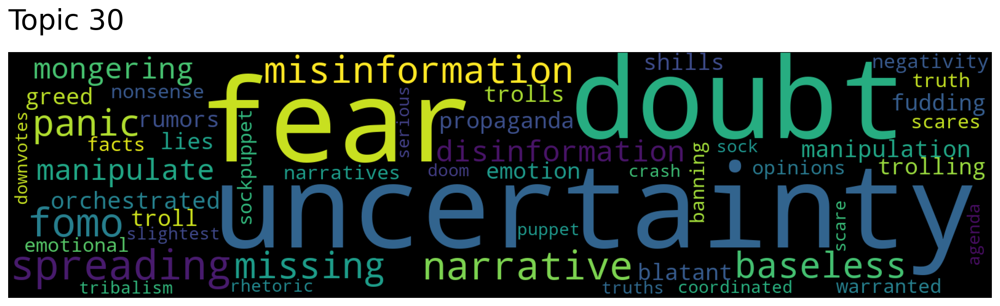

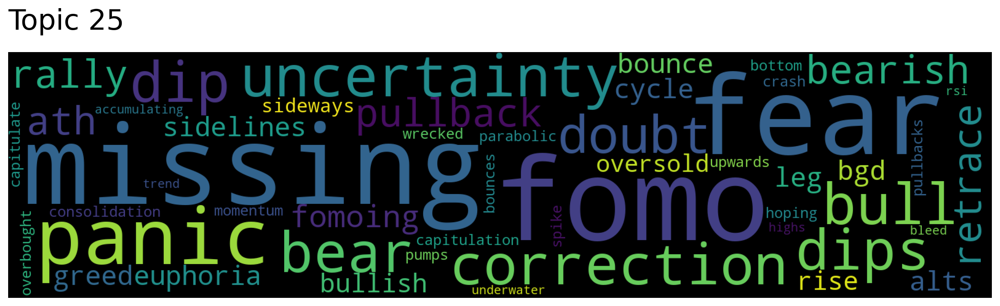

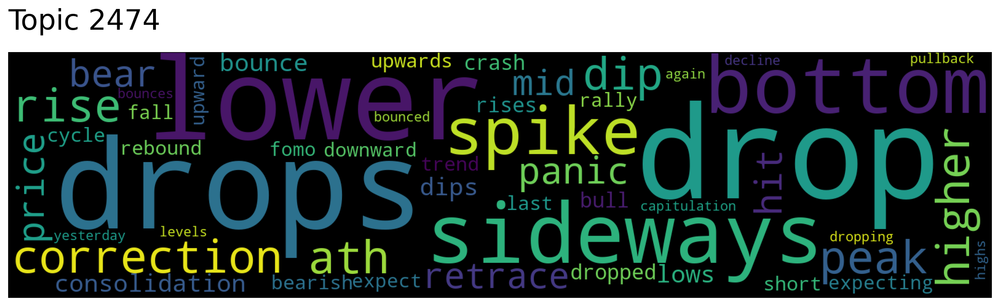

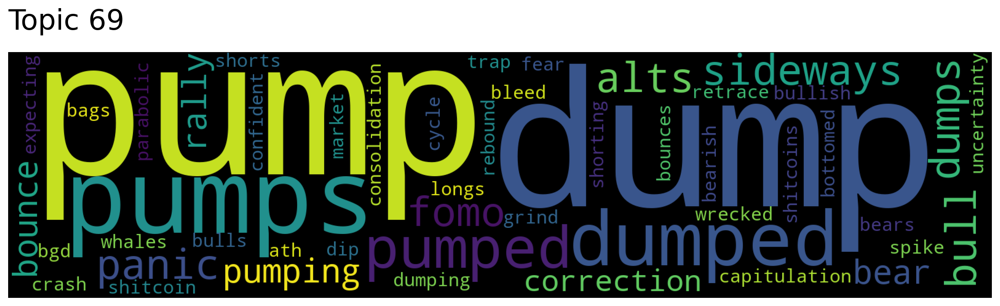

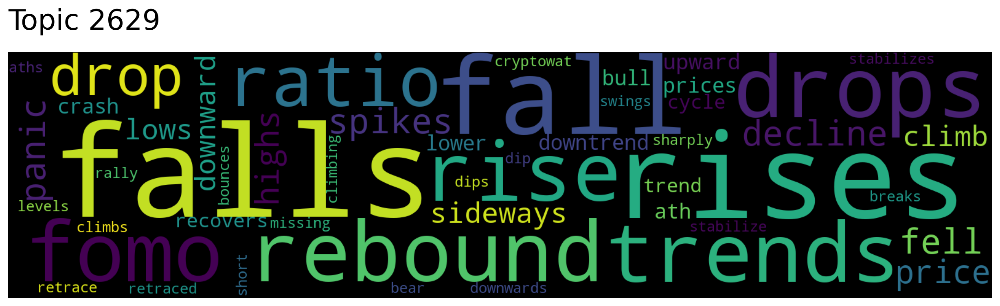

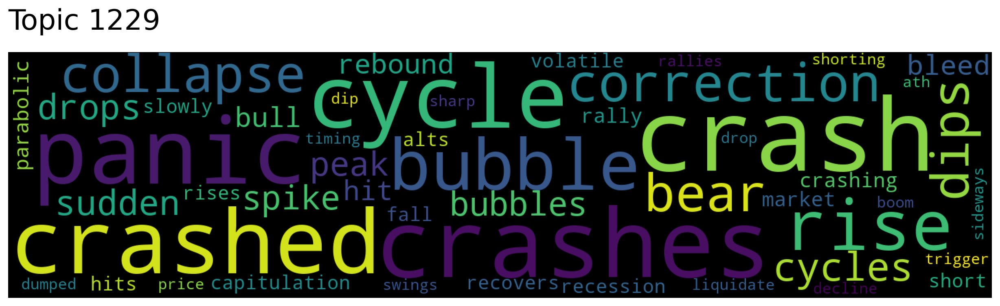

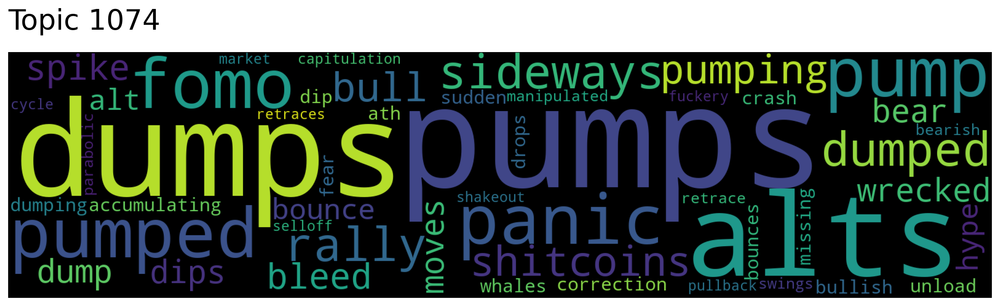

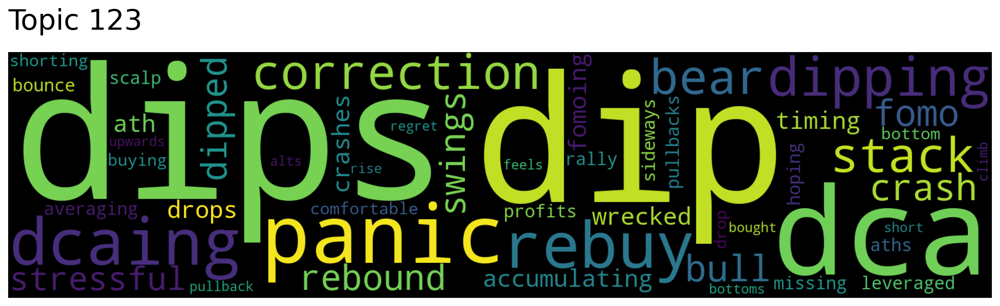

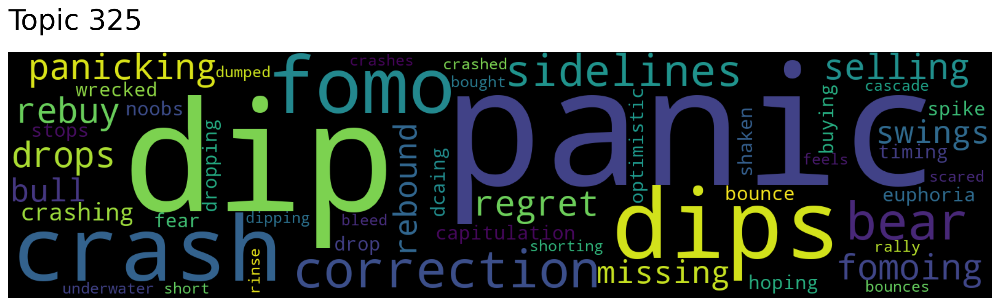

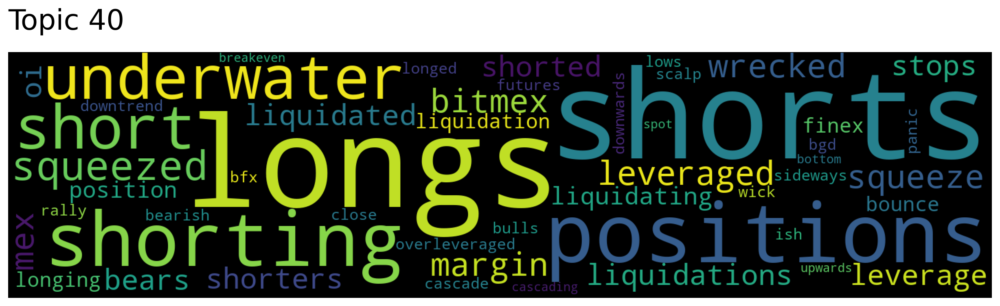

In [55]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)

**Identify Topics Related to Policy Uncertainty**

In [56]:
topic_words, word_scores, topic_scores, topic_nums = (
    t2v10_model.search_topics(
        keywords=["uncertainty", "policy"],
        num_topics=10
    )
)

In [57]:
topic_scores

array([0.51298477, 0.38484907, 0.28488338, 0.25979777, 0.25155252,
       0.24700347, 0.24651619, 0.23872575, 0.23035165, 0.22824589])

In [58]:
# Pick relevant words in relevant topics
list(zip(list(topic_words[0]), list(word_scores[0])))

[('uncertainty', 0.72409743),
 ('fear', 0.70776016),
 ('doubt', 0.67005664),
 ('spreading', 0.49395713),
 ('fomo', 0.44544762),
 ('narrative', 0.40840736),
 ('misinformation', 0.393205),
 ('missing', 0.37283644),
 ('panic', 0.35924244),
 ('baseless', 0.32947832),
 ('disinformation', 0.32821208),
 ('mongering', 0.32693008),
 ('manipulate', 0.31614727),
 ('manipulation', 0.31588498),
 ('orchestrated', 0.31426892),
 ('propaganda', 0.30862248),
 ('fudding', 0.30104932),
 ('trolling', 0.2950872),
 ('rumors', 0.29495695),
 ('shills', 0.2857758),
 ('troll', 0.2826002),
 ('blatant', 0.28236017),
 ('emotion', 0.27979544),
 ('trolls', 0.27558774),
 ('greed', 0.2714109),
 ('lies', 0.27124107),
 ('negativity', 0.2671276),
 ('banning', 0.2659008),
 ('facts', 0.25894794),
 ('warranted', 0.25236708),
 ('sockpuppet', 0.25100338),
 ('nonsense', 0.2504321),
 ('opinions', 0.25023827),
 ('narratives', 0.24959046),
 ('scares', 0.24932888),
 ('truth', 0.24677812),
 ('emotional', 0.24597673),
 ('slightest', 

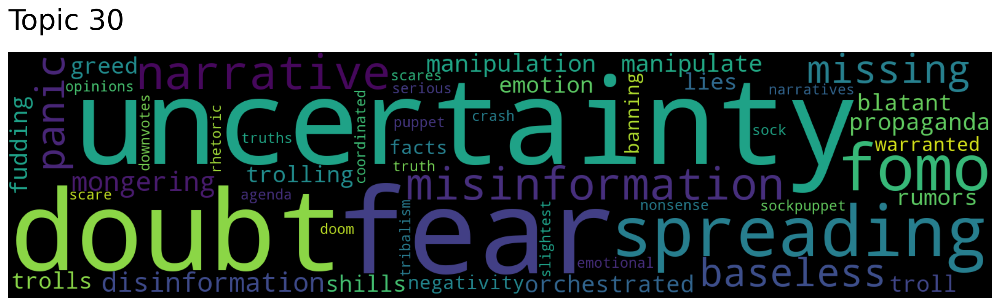

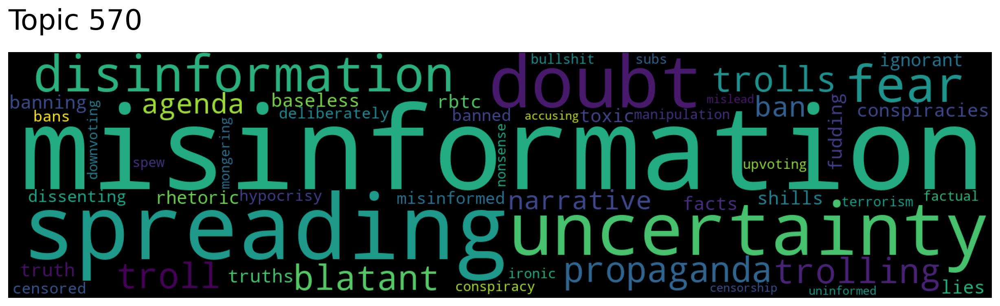

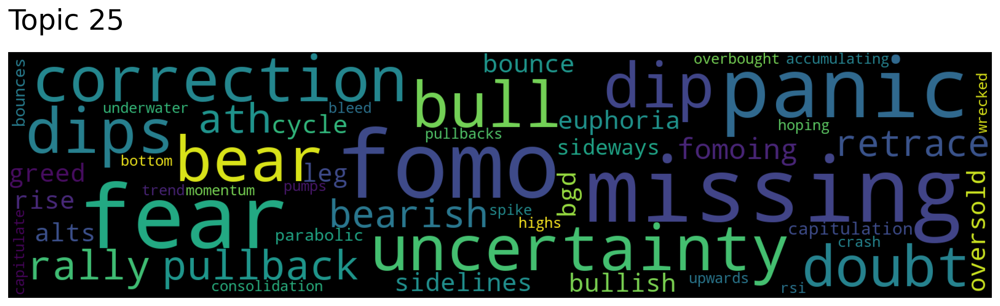

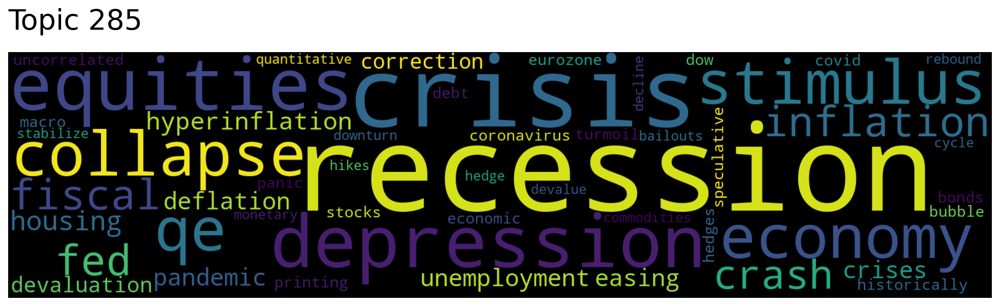

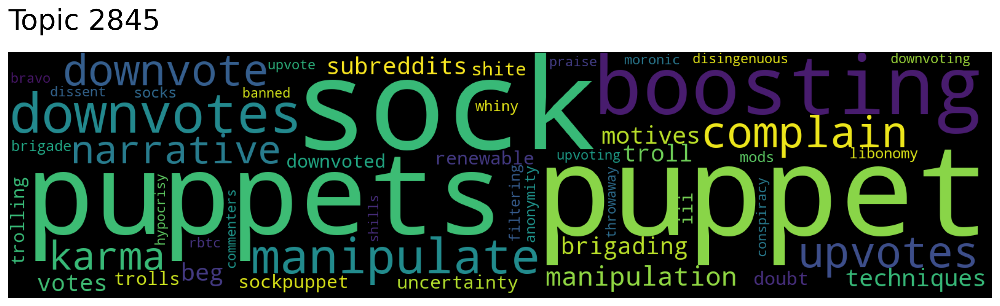

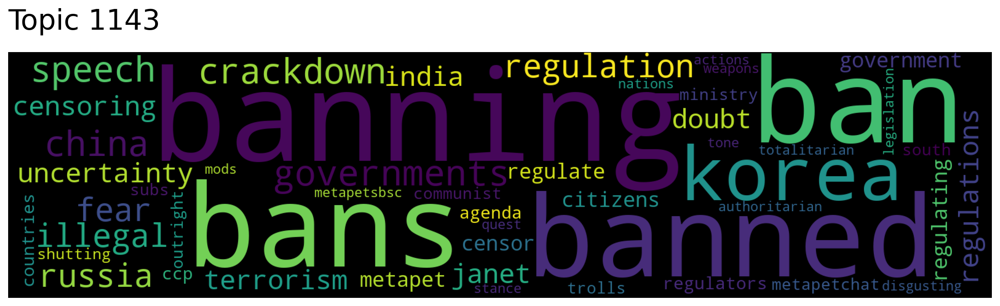

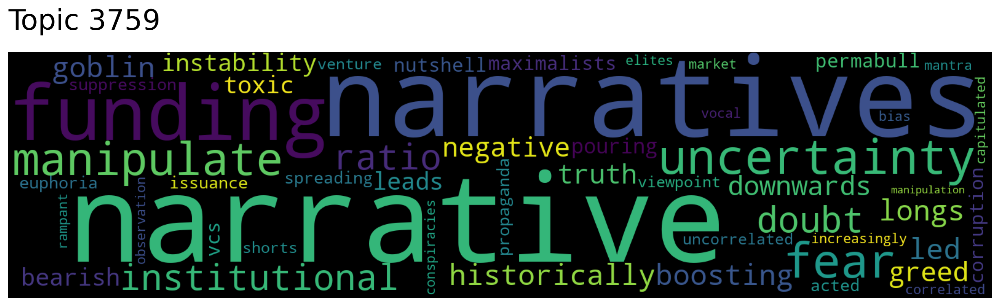

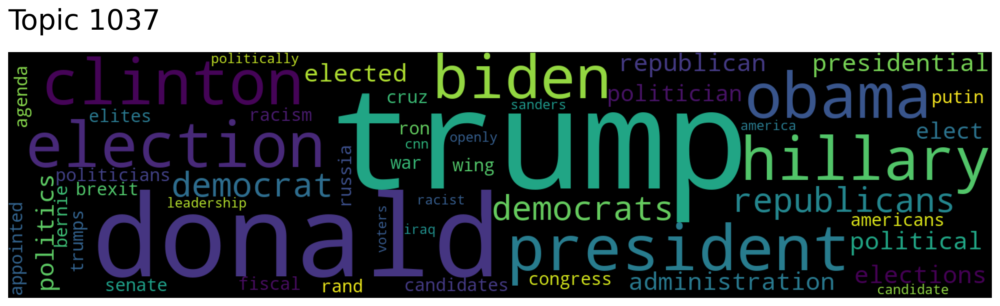

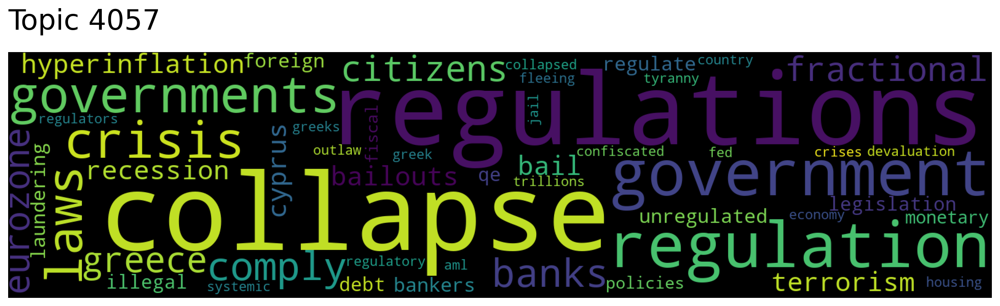

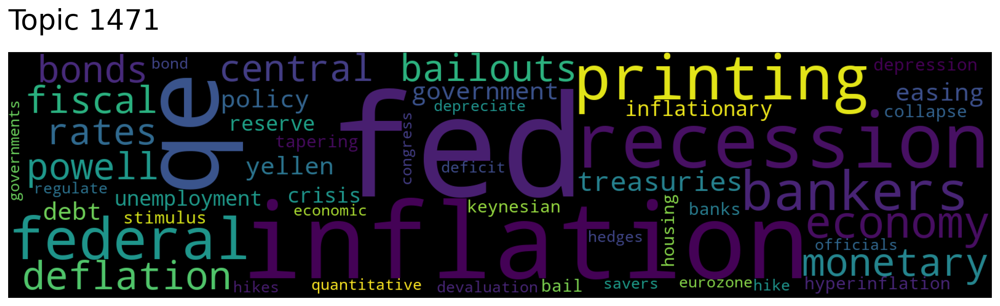

In [59]:
# Visualise in Word Clouds
for topic in topic_nums:
    t2v10_model.generate_topic_wordcloud(topic)